In [1]:
import dask

dask.config.set({"dataframe.query-planning": False})

import numpy as np
from pathlib import Path
import pandas as pd
import scanpy as sc
import scipy
import seaborn as sns
import matplotlib.pyplot as plt

import sys
sys.path.extend(['../../scripts','../../scripts/xenium'])
import readwrite
import _utils

cfg = readwrite.config()

/work/PRTNR/CHUV/DIR/rgottar1/spatial/env/jbac/miniforge3/envs/spatial/lib/python3.11/importlib/__init__.py:126: FutureWarning: The legacy Dask DataFrame implementation is deprecated and will be removed in a future version. Set the configuration option `dataframe.query-planning` to `True` or None to enable the new Dask Dataframe implementation and silence this warning.
  return _bootstrap._gcd_import(name[level:], package, level)
/work/PRTNR/CHUV/DIR/rgottar1/spatial/env/jbac/miniforge3/envs/spatial/lib/python3.11/site-packages/cudf/utils/_ptxcompiler.py:64: UserWarning: Error getting driver and runtime versions:

stdout:



stderr:

Traceback (most recent call last):
  File "<string>", line 4, in <module>
  File "/work/PRTNR/CHUV/DIR/rgottar1/spatial/env/jbac/miniforge3/envs/spatial/lib/python3.11/site-packages/numba_cuda/numba/cuda/cudadrv/driver.py", line 272, in __getattr__
    raise CudaSupportError("Error at driver init: \n%s:" %
numba.cuda.cudadrv.error.CudaSupportError: Error a

In [9]:
condition = 'NSCLC'
panel = '5k'
correction_methods = ['raw',]
xenium_processed_data_dir = Path(cfg["xenium_processed_data_dir"])
xenium_count_correction_dir = Path(cfg["xenium_count_correction_dir"])
std_seurat_analysis_dir = Path(cfg["xenium_std_seurat_analysis_dir"])
cell_type_annotation_dir = Path(cfg["xenium_cell_type_annotation_dir"])
scrnaseq_processed_data_dir = Path(cfg["scrnaseq_processed_data_dir"])
results_dir = Path(cfg["results_dir"])
palette_dir = Path(cfg["xenium_metadata_dir"])
figures_dir = Path(cfg["figures_dir"])
seurat_to_h5_dir = results_dir / "seurat_to_h5"
normalisation = 'lognorm'
layer = 'data'
reference = 'matched_reference_combo'
method = 'rctd_class_aware'
level = 'Level2.1'
mixture_k = 50
num_samples = 30


xenium_paths = {}
xenium_annot_paths = {}
xenium_score_mat_paths = {}
for correction_method in correction_methods:
    xenium_paths[correction_method] = {}
    xenium_annot_paths[correction_method] = {}
    xenium_score_mat_paths[correction_method] = {}

    for segmentation in (segmentations := std_seurat_analysis_dir.iterdir()):
        if segmentation.stem != "10x_mm_5um":
            continue
        for condition_dir in (conditions := segmentation.iterdir()):
            if condition_dir.stem != condition:
                continue
            for panel_dir in (panels := condition_dir.iterdir()):
                if panel_dir.stem != panel:
                    continue
                for donor in (donors := panel_dir.iterdir()):
                    for sample in (samples := donor.iterdir()):
                        if sample.stem != '1G73':
                            continue
                        
                        k = (segmentation.stem, condition_dir.stem, panel_dir.stem, donor.stem, sample.stem)
                        name = "/".join(k)

                        # raw samples
                        if "proseg" in segmentation.stem:
                            k_proseg = ("proseg", condition_dir.stem, panel_dir.stem, donor.stem, sample.stem)
                            name_proseg = "/".join(k_proseg)
                            sample_dir = xenium_processed_data_dir / f"{name_proseg}/raw_results"
                        else:
                            sample_dir = xenium_processed_data_dir / f"{name}/normalised_results/outs"

                        sample_annotation = (
                            cell_type_annotation_dir
                            / f"{name}/{normalisation}/reference_based/{reference}/{method}/{level}/single_cell/output/post_processed_results_df.parquet"
                        )

                        sample_score_mat = (
                            cell_type_annotation_dir
                            / f"{name}/{normalisation}/reference_based/{reference}/{method}/{level}/single_cell/output/score_mat.parquet"
                        )

                                
                        if correction_method == "raw":
                            xenium_paths[correction_method][k] = sample_dir
                            xenium_annot_paths[correction_method][k] = sample_annotation
                            xenium_score_mat_paths[correction_method][k] = sample_score_mat


                        # corrected samples
                        else:
                            if correction_method == "split_fully_purified":
                                name_corrected = f"{name}/{normalisation}/reference_based/{reference}/{method}/{level}/single_cell/split_fully_purified/"
                                sample_corrected_counts_path = (
                                    xenium_count_correction_dir / f"{name_corrected}/corrected_counts.h5"
                                )

                            else:
                                if correction_method == "resolvi":
                                    name_corrected = f"{name}/{mixture_k=}/{num_samples=}/"
                                elif correction_method == "resolvi_supervised":
                                    name_corrected = f"{name}/{normalisation}/reference_based/{reference}/{method}/{level}/{mixture_k=}/{num_samples=}"
                                elif "ovrlpy" in correction_method:
                                    name_corrected = f"{name}"

                                sample_corrected_counts_path = (
                                    results_dir / f"{correction_method}/{name_corrected}/corrected_counts.h5"
                                )
                            # sample_normalised_counts = (
                            #     std_seurat_analysis_dir / f"{name}/{normalisation}/normalised_counts/{layer}.parquet"
                            # )
                            # sample_idx = (
                            #     std_seurat_analysis_dir / f"{name}/{normalisation}/normalised_counts/cells.parquet"
                            # )

                            xenium_paths[correction_method][k] = sample_corrected_counts_path


ads = readwrite.read_count_correction_samples(xenium_paths, correction_methods[1:])
ads["raw"] = readwrite.read_xenium_samples(xenium_paths["raw"], anndata=True, max_workers=6)


for correction_method in correction_methods:

    for k, ad in ads[correction_method].items():
        if ad is not None:
            if correction_method == "raw":
                if k[0] == "proseg_expected":
                    ad.obs_names = ad.obs_names.astype(str)
                    ad.obs_names = "proseg-" + ad.obs_names

                # filter cells and read labels for raw
                df_annot = pd.read_parquet(xenium_annot_paths["raw"][k]).set_index("cell_id")
                ad.uns['df_score_mat'] = pd.read_parquet(xenium_score_mat_paths["raw"][k])
                ad.obs =  ad.obs.join(df_annot)
                ad.obs[level] = ad.obs['first_type']

                ad = ad[ad.obs[level].notna()]
                if level == "Level2.1":
                    # for custom Level2.1, simplify subtypes
                    ad.obs.loc[ad.obs[level].str.contains("malignant"), level] = "malignant cell"
                    ad.obs.loc[ad.obs[level].str.contains("T cell"), level] = "T cell"

                # remove tissue from cell type name
                ad.obs[level] = ad.obs[level].str.replace(r" of .+", "", regex=True)
                ads["raw"][k] = ad
                

            # filter cells and add labels from raw
            if correction_method != "raw":
                ad.obs[level] = ads["raw"][k].obs[level]
                ad = ad[[c for c in ads["raw"][k].obs_names if c in ad.obs_names]]
                ads[correction_method][k] = ad


INFO     reading                                                                                                   
         /work/PRTNR/CHUV/DIR/rgottar1/spatial/env/xenium_paper/data/xenium/processed/segmentation/10x_mm_5um/NSCLC
         /5k/1G73/1G73/normalised_results/outs/cell_feature_matrix.h5                                              


/work/PRTNR/CHUV/DIR/rgottar1/spatial/env/jbac/miniforge3/envs/spatial/lib/python3.11/site-packages/spatialdata/_core/spatialdata.py:185: UserWarning: The table is annotating 'cell_labels', which is not present in the SpatialData object.
  self.validate_table_in_spatialdata(v)
/tmp/ipykernel_4066096/1191026904.py:127: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  ad.obs[level] = ad.obs[level].str.replace(r" of .+", "", regex=True)


In [80]:
sample = list(ads['raw'])[0]
ad = ads['raw'][sample]

In [187]:
ad.obs['cell_type']=ad.obs[level]
detect_tls(ad,
    radius = 50,
    b_cell_label = 'B cell',
    t_cell_label = 'T cell',
    min_perc_b = 0.0, # Added: Min % B cells in neighborhood (0.0-1.0)
    min_perc_t = 0.0, # Added: Min % T cells in neighborhood (0.0-1.0)
    fold_change_threshold = 1.5,
    min_b = 5, # Min absolute number of B cells in neighborhood
    min_t = 5, # Min absolute number of T cells in neighborhood
    min_tls_size = 20, # Used for HDBSCAN min_cluster_size AND post-filter B+T count
)

--- Starting TLS Detection (Fixed % / Abs Count Thresholds, sklearn HDBSCAN) ---
Params: radius=50, min_perc_b=0.00, min_perc_t=0.00, min_abs_count_b=5, min_abs_count_t=5, min_tls_size=20 (used for HDBSCAN min_cluster_size & final filter)
Global props (for info): B=0.0094, T=0.1023
Building detection radius neighbors graph (radius=50, n_jobs=1)...
Calculating detection neighborhood compositions...
Identifying candidate cells based on fixed thresholds...
Found 3565 candidate cells.
Clustering candidate cells using sklearn.cluster.HDBSCAN (min_cluster_size=20)...
HDBSCAN found 27 initial clusters and 48 noise points.
Filtering clusters by minimum biological size (>= 20 B+T cells)...
  Cluster 1 PASSED: 527 B+T cells. Assigned TLS label 0.
  Cluster 2 PASSED: 74 B+T cells. Assigned TLS label 1.
  Cluster 7 PASSED: 23 B+T cells. Assigned TLS label 2.
  Cluster 11 PASSED: 45 B+T cells. Assigned TLS label 3.
  Cluster 13 PASSED: 64 B+T cells. Assigned TLS label 4.
  Cluster 16 PASSED: 99 B+T

AnnData object with n_obs × n_vars = 215668 × 5001
    obs: 'cell_id', 'transcript_counts', 'control_probe_counts', 'genomic_control_counts', 'control_codeword_counts', 'unassigned_codeword_counts', 'deprecated_codeword_counts', 'total_counts', 'cell_area', 'nucleus_area', 'nucleus_count', 'segmentation_method', 'region', 'z_level', 'spot_class', 'first_type', 'scond_type', 'first_class', 'second_class', 'min_score', 'singlet_score', 'conv_all', 'conv_doublet', 'second_type', 'max_doublet_weight', 'n_candidates', 'rctd_weights_entropy', 'singlet_score_first', 'singlet_score_second', 'delta_singlet_score_first_second', 'score_diff', 'score_diff_old', 'delta_singlet_score_original_first_class', 'weight_first_type', 'weight_second_type', 'delta_singlet_score', 'delta_singlet_score_class', 'first_type_class', 'second_type_class', 'same_class', 'x', 'y', 'nCount', 'nFeature', 'score_diff_normalized', 'is_singlet_in_normalized_thresh', 'spot_class_normalized', 'annot_min_singlet_score', 'ann

In [1]:
ad

NameError: name 'ad' is not defined

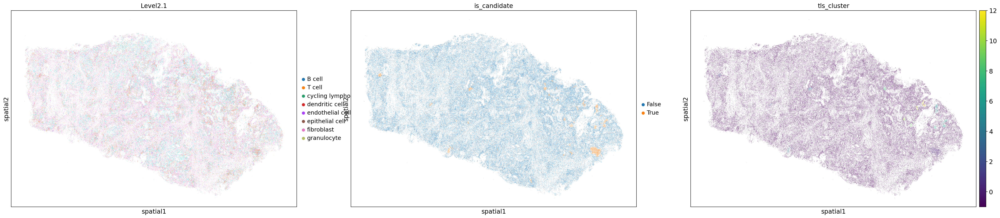

In [188]:
sc.pl.embedding(ad,'spatial',color=[level,'is_candidate','tls_cluster'])

/work/PRTNR/CHUV/DIR/rgottar1/spatial/env/jbac/miniforge3/envs/spatial/lib/python3.11/site-packages/anndata/_core/anndata.py:1146: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c


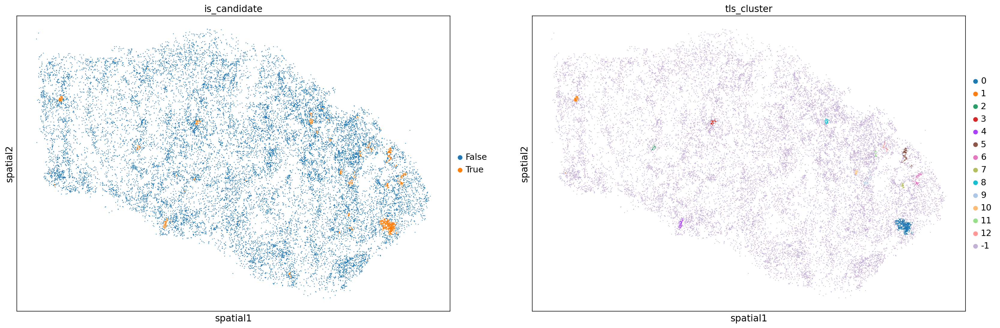

In [189]:
ad.obs['tls_cluster'] = ad.obs['tls_cluster'].astype(str)

sc.pl.embedding(ad[ad.obs[level].isin(['B cell', 'T cell'])],'spatial',color=['is_candidate','tls_cluster'])

/work/PRTNR/CHUV/DIR/rgottar1/spatial/env/jbac/miniforge3/envs/spatial/lib/python3.11/site-packages/anndata/_core/anndata.py:1146: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c


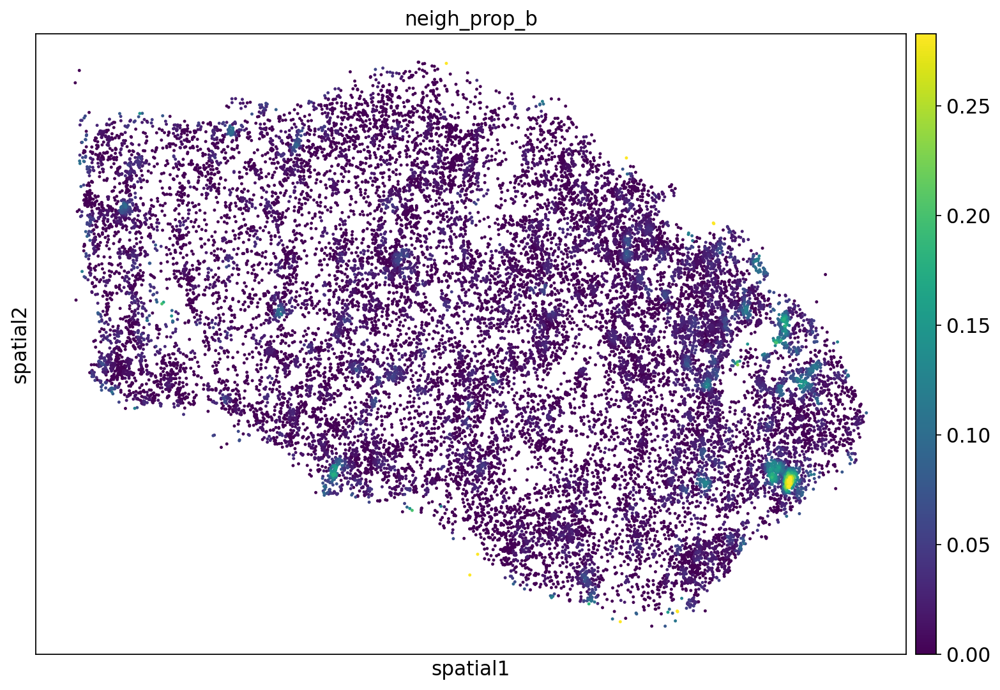

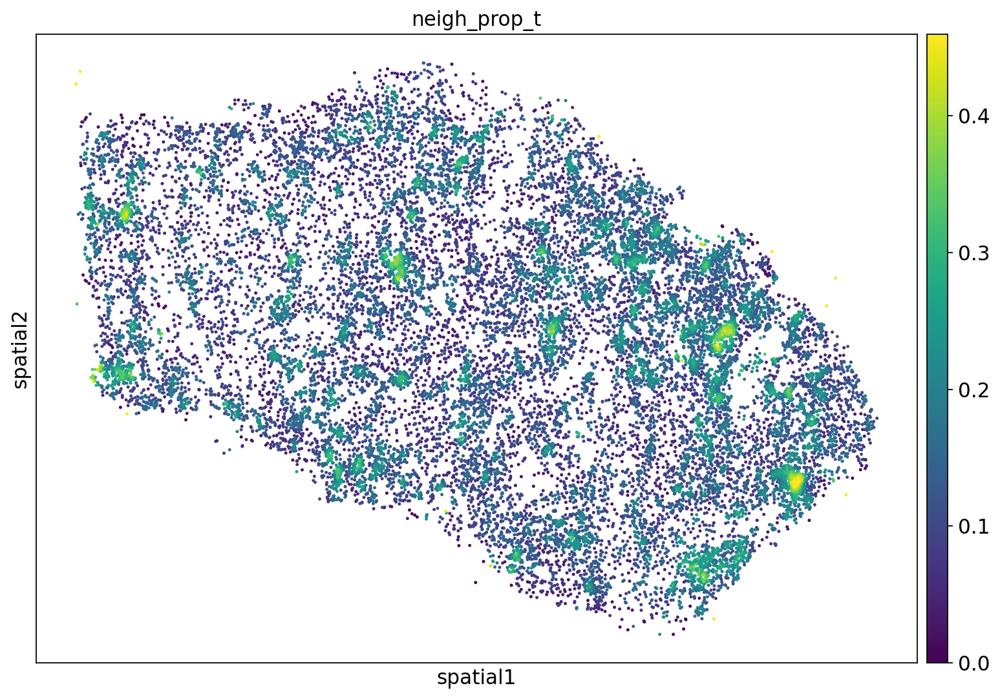

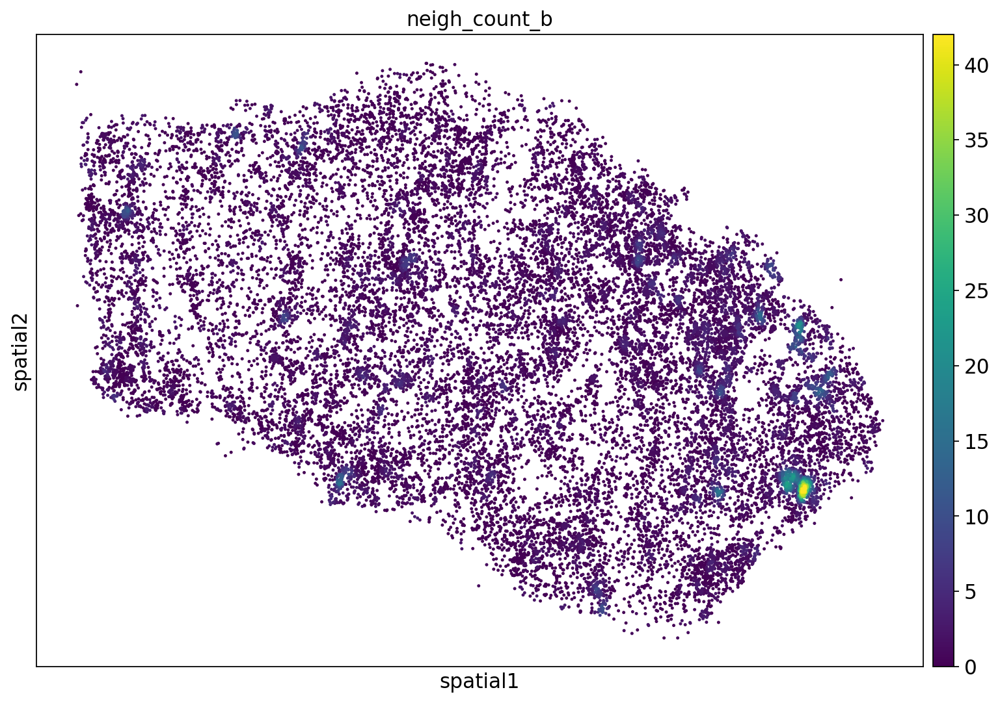

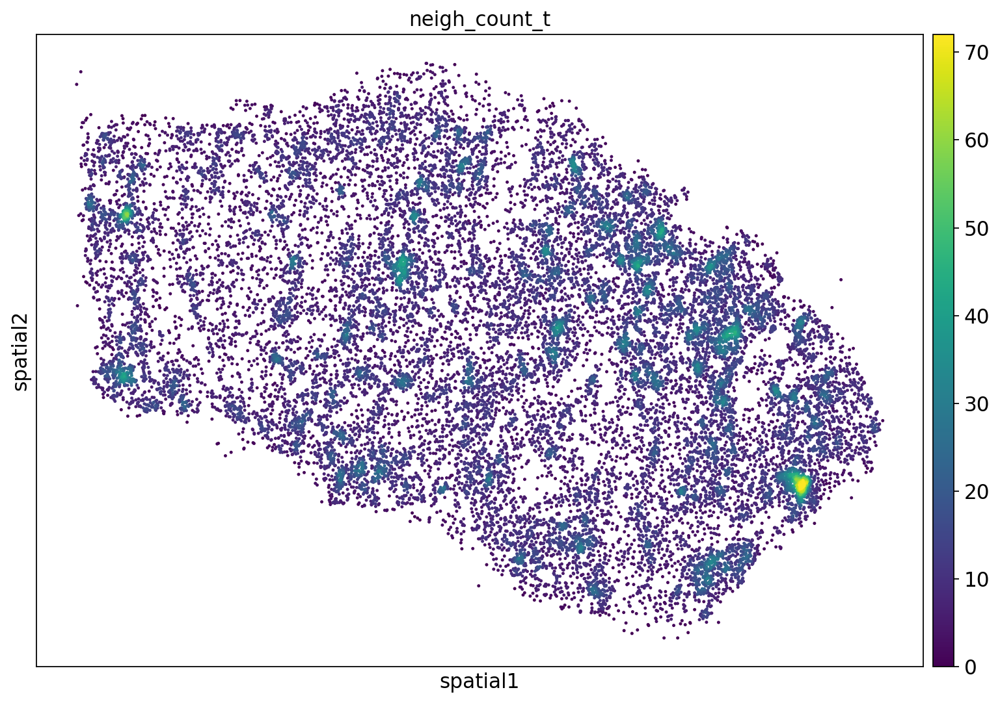

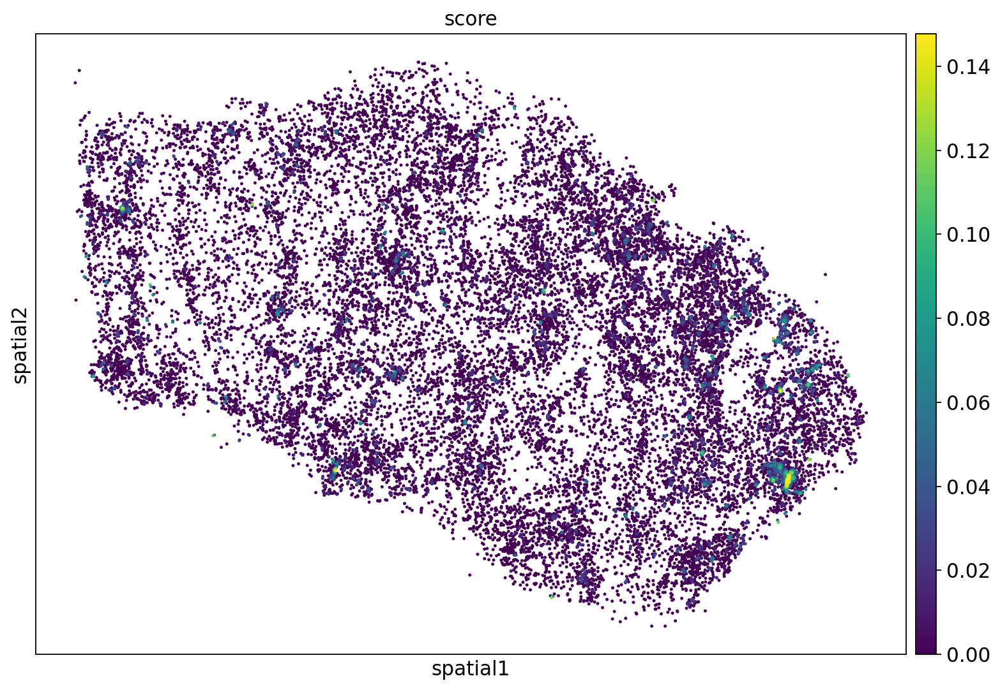

In [180]:
sc.settings.set_figure_params(figsize=(12, 8))
ad_plot = ad[ad.obs[level].isin(['B cell', 'T cell'])]
for c in ['neigh_prop_b','neigh_prop_t','neigh_count_b','neigh_count_t','score']:
    sc.pl.embedding(ad_plot,'spatial',color=c,s=20,vmax=np.percentile(ad_plot.obs[c],99.9))

raw


/work/PRTNR/CHUV/DIR/rgottar1/spatial/env/jbac/miniforge3/envs/spatial/lib/python3.11/site-packages/scanpy/preprocessing/_normalization.py:207: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


knn...
knn labels...
get TLS score and cluster...


/tmp/ipykernel_4066096/994796027.py:70: FutureWarning: Downcasting behavior in `replace` is deprecated and will be removed in a future version. To retain the old behavior, explicitly call `result.infer_objects(copy=False)`. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  ad_.obs[cluster].replace(dict(zip(knnlabels.columns,np.arange(len(knnlabels.columns))))).astype(int).values]=0.
/tmp/ipykernel_4066096/994796027.py:70: FutureWarning: The behavior of Series.replace (and DataFrame.replace) with CategoricalDtype is deprecated. In a future version, replace will only be used for cases that preserve the categories. To change the categories, use ser.cat.rename_categories instead.
  ad_.obs[cluster].replace(dict(zip(knnlabels.columns,np.arange(len(knnlabels.columns))))).astype(int).values]=0.


split clusters by coordinates...


/work/PRTNR/CHUV/DIR/rgottar1/spatial/env/jbac/miniforge3/envs/spatial/lib/python3.11/site-packages/anndata/_core/anndata.py:1146: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c
/work/PRTNR/CHUV/DIR/rgottar1/spatial/env/jbac/miniforge3/envs/spatial/lib/python3.11/site-packages/anndata/_core/anndata.py:1146: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c
/work/PRTNR/CHUV/DIR/rgottar1/spatial/env/jbac/miniforge3/envs/spatial/lib/python3.11/site-packages/anndata/_core/anndata.py:1146: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c
/work/PRTNR/CHUV/DIR/rgottar1/spatial/env/jbac/miniforge3/envs/spatial/lib/python3.11/site-packages/anndata/_core/anndata.py:1146: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c
/work/PRTNR/CHUV

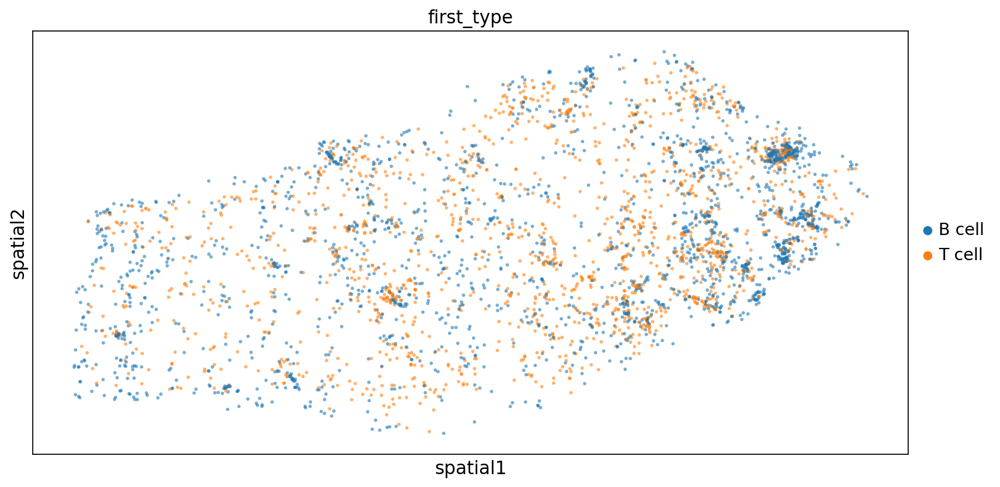

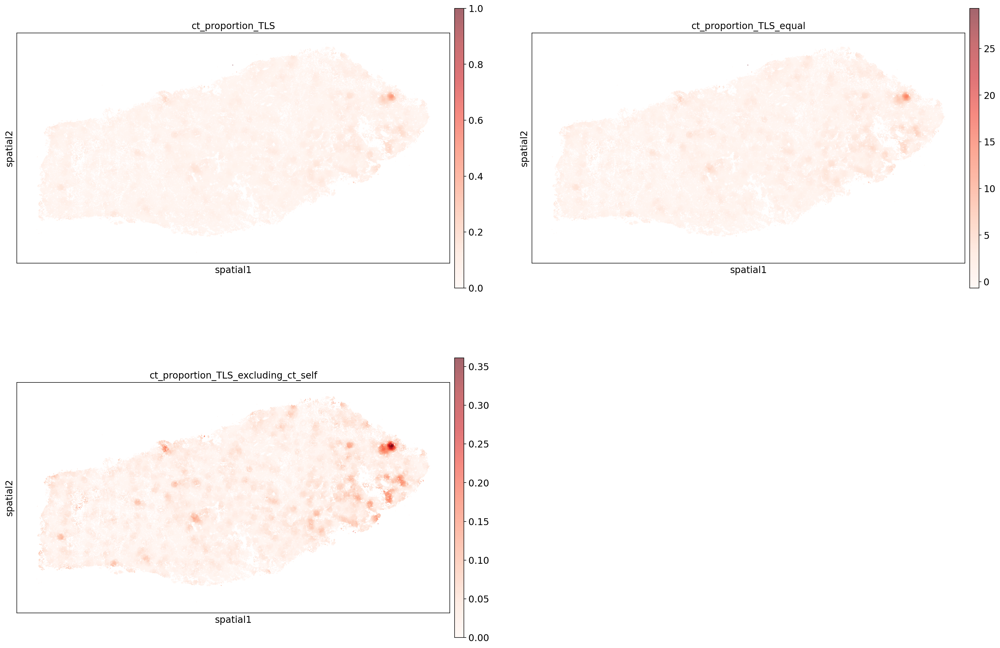

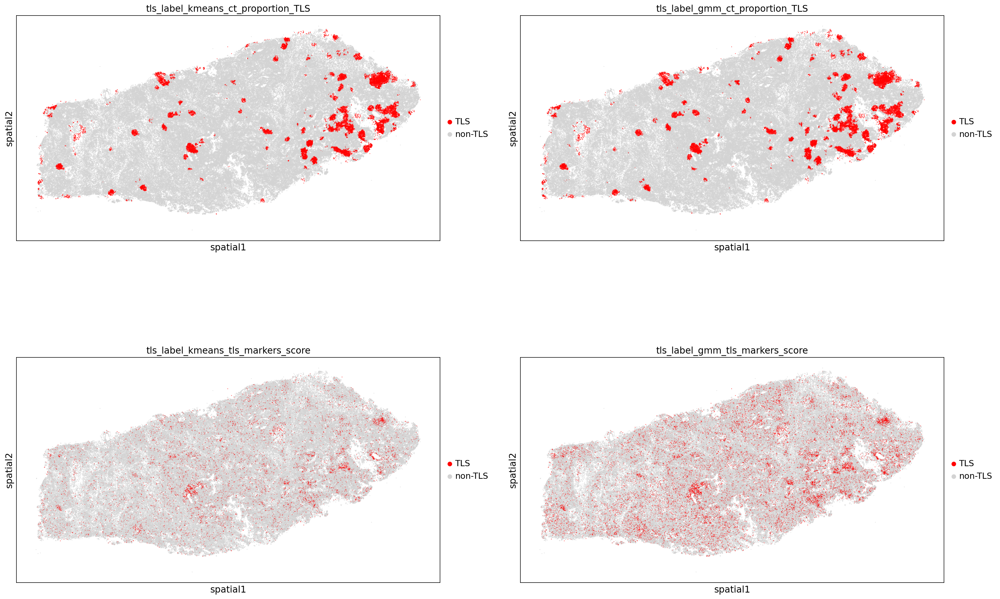

KeyError: ('10x_mm_5um', 'NSCLC', '5k', '1G73', '1G73')

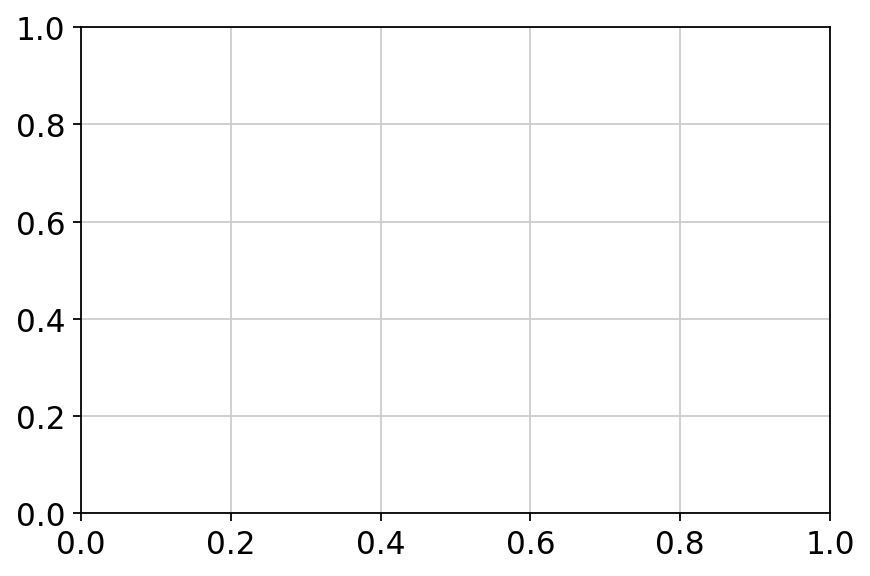

In [141]:
import sklearn
import networkx as nx
# import skbio
import sys; sys.path.append('..')
sys.path.append('/work/PRTNR/CHUV/DIR/rgottar1/spatial/env/jbac/projects/scripts/coda')
sys.path.append('/work/PRTNR/CHUV/DIR/rgottar1/spatial/env/jbac/projects/scripts/communication')
sys.path.append('/work/PRTNR/CHUV/DIR/rgottar1/spatial/env/jbac/projects/scripts/utils')

import ilr_transform
from general import list_of_indices_to_labels, sparse_to_knn

cluster = 'first_type'
method = 'kmeans'
tls_proportions = 'sum'
ct_TLS = ['B cell','T cell']
tls_markers = [
'CXCL13', 'CXCR5',# B/T cells
'MS4A1', 'MME',# B cells
'CXCR5',# T cells
# 'COL1A1',#fibrotic envirionment
'CCL19',#'CCR7' # T/DC]
]
plot = 'subsample'
plot = True

def _relabel_tls(k_cluster,use_key): 
    map_ = dict(zip(ad_.obs.groupby(k_cluster).agg({use_key:'mean'})[use_key].sort_values().index,
                        ['non-TLS','TLS']))
    ad_.obs[k_cluster] = ad_.obs[k_cluster].replace(map_)


TLS_compositional_avg = {}
print(name)
TLS_compositional_avg[name] = {}

ad_ = ad[~ad.obs[cluster].isna()]
sc.pp.normalize_total(ad_)
sc.pp.log1p(ad_) 

# knn
print('knn...')
ad_.obsp['spatial_connectivities'] = radius_neighbors_graph(
    ad_.obsm['spatial'], radius=75, mode='connectivity', include_self=True, n_jobs=1
)

g = ad_.obsp['spatial_connectivities'].copy()
g.setdiag(1) #include cell in its own neighborhood
knnidx, knndist = sparse_to_knn(g)

# labels of 1st nearest neighbor
ad_.obs[cluster+'_1nn'] = [ad_.obs[cluster].iloc[knn].value_counts().idxmax() for knn in knnidx]

# knn labels
print('knn labels...')
df_dummies = pd.get_dummies(ad_.obs[cluster])
knnlabels = ilr_transform.get_knn_labels(knnidx=knnidx,dummy_array=pd.get_dummies(ad_.obs[cluster]))
knnlabels = pd.DataFrame(knnlabels, index=ad_.obs.index, columns=df_dummies.columns)
knnlabels_percent = knnlabels.div(knnlabels.sum(1),axis=0)
ad_.uns['knnlabels_percent'] = knnlabels_percent

# get TLS score and cluster
print('get TLS score and cluster...')
ad_.obs['tls_markers_score'] = scipy.stats.zscore(ad_[:,tls_markers].X.toarray()).mean(1)
ad_.obs['ct_proportion_TLS'] = knnlabels_percent[ct_TLS].sum(1)
ad_.obs['ct_proportion_TLS_equal'] = scipy.stats.zscore(knnlabels_percent[ct_TLS]).mean(1)
ad_.obs['ct_proportion_TLS_excluding_ct_self'] = 0.

knnlabels_percent.values[
    np.arange(len(ad_)),
    ad_.obs[cluster].replace(dict(zip(knnlabels.columns,np.arange(len(knnlabels.columns))))).astype(int).values]=0.
ad_.obs['ct_proportion_TLS_excluding_ct_self'] = knnlabels_percent[ct_TLS].sum(1)

if tls_proportions == 'sum':
    use_key = "ct_proportion_TLS"
elif tls_proportions == 'equal':
    use_key = "ct_proportion_TLS_equal"
elif tls_proportions == 'sum_excluding_ct_self':
    use_key = "ct_proportion_TLS_excluding_ct_self"

clfs = [sklearn.cluster.KMeans(n_clusters=2),sklearn.mixture.GaussianMixture(n_components=2)]
for n,clf in zip(['kmeans','gmm'],clfs):
    for k_clus in [use_key,'tls_markers_score']:
        ad_.obs[f'tls_label_{n}_{k_clus}'] = clf.fit_predict(ad_.obs[k_clus].values.reshape(-1, 1)).astype(str)
        _relabel_tls(f'tls_label_{n}_{k_clus}',k_clus)

# split clusters by coordinates
print('split clusters by coordinates...')
tls_idx = ad_.obs[f'tls_label_{method}_{use_key}']=='TLS'
G=nx.Graph(ad_[tls_idx].obsp['spatial_connectivities'])
connected_components = list(nx.connected_components(G))

ad_.obs[f'tls_split_label_{method}'] = -1
ad_.obs.loc[tls_idx,f'tls_split_label_{method}'] = list_of_indices_to_labels(connected_components,len(G))
ad_.obs[f'tls_split_label_{method}'] = ad_.obs[f'tls_split_label_{method}'].astype(str)

# filter out small clusters
tls_clusters_n_cells = ad_.obs[f'tls_split_label_{method}'].value_counts()
filter_tls_small_n_cells = tls_clusters_n_cells[tls_clusters_n_cells<100].index
ad_.obs[f'tls_split_label_{method}_filtered'] = ad_.obs[f'tls_split_label_{method}'].replace(filter_tls_small_n_cells,'-1')

# print('ILR mean...')
# for c in ad_.obs[f'tls_split_label_{method}_filtered'].unique():
#     ix_clus = ad_.obs[f'tls_split_label_{method}_filtered']==c
#     X_ilr = skbio.stats.composition.ilr(knnlabels_percent.loc[ix_clus.values,ct_TLS]+0.01)
#     TLS_compositional_avg[name][c] = skbio.stats.composition.ilr_inv(X_ilr.mean(axis=0))


ad.obs=ad.obs.join(ad_.obs[[c for c in ad_.obs.columns if c not in ad.obs]])
ad.uns['knnlabels'] = knnlabels

if plot or plot=='subsample':
    if plot=='subsample':
        ad_plot = sc.pp.subsample(ad_, n_obs=10000, copy=True)
    else:
        ad_plot = ad_

    # plot scores and clustering
    sc.pl.spatial(ad_plot[ad_plot.obs['first_type'].isin(ct_TLS)],color='first_type',spot_size=40,alpha=.6)
    sc.pl.spatial(ad_plot,color=['ct_proportion_TLS','ct_proportion_TLS_equal','ct_proportion_TLS_excluding_ct_self'],
                    spot_size=20,alpha=.6,ncols=2,cmap='Reds')
    sc.pl.spatial(ad_plot,color=[f'tls_label_kmeans_{use_key}',f'tls_label_gmm_{use_key}',
                            'tls_label_kmeans_tls_markers_score','tls_label_gmm_tls_markers_score'],
                            spot_size=20,alpha=.6,ncols=2,palette={'TLS':'red','non-TLS':'lightgray'})

    # plot score distribution and threshold
    plt.figure(figsize=(6,4))
    ax = plt.subplot()
    ax.hist(ad_plot.obs[k],bins=100)
    threshold_kmeans = ad_plot.obs.loc[ad_plot.obs[f'tls_label_kmeans_{use_key}']=='1',k].min()
    threshold_gmm = ad_plot.obs.loc[ad_plot.obs[f'tls_label_gmm_{use_key}']=='1',k].min()
    ax.axvline(x=threshold_kmeans,color='r',linestyle='dashed',linewidth=1,label='kmeans')
    ax.axvline(x=threshold_gmm,color='k',linestyle='dashed',linewidth=1,label='gmm')
    plt.legend()
    plt.show()
    
    # plot split clusters
    palette = dict(zip(ad_plot.obs[f'tls_split_label_{method}_filtered'].unique(),sc.pl.palettes.default_102))
    palette['-1'] = 'lightgray'
    sc.pl.spatial(ad_plot,color=f'tls_split_label_{method}_filtered',spot_size=20,alpha=.6,palette=palette)

    #plot markers
    for m in tls_markers:
        x = ad_plot[:,m].X.toarray().squeeze()
        ad_plot.obs[m+'_winsorized'] = np.clip(x,None,np.percentile(x,98))
    sc.pl.spatial(ad_plot,color=(m+'_winsorized' for m in tls_markers),spot_size=20,alpha=.6,cmap='Reds')